## study_styletransfer.ipynb

In [18]:
!pip install tensorflow

In [19]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np

In [20]:
network = tf.keras.applications.VGG19(include_top = False, weights = "imagenet")

In [21]:
network.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0     

In [22]:
len(network.layers)

22

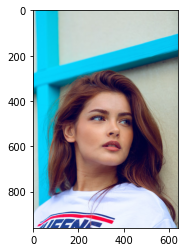

In [23]:
content_image = tf.keras.preprocessing.image.load_img("g2.jpg")
plt.imshow(content_image)

In [24]:
type(content_image)

PIL.JpegImagePlugin.JpegImageFile

In [25]:
content_image = tf.keras.preprocessing.image.img_to_array(content_image)

In [26]:
type(content_image), content_image.shape, content_image.min(), content_image.max()

(numpy.ndarray, (960, 640, 3), 0.0, 255.0)

In [27]:
content_image = content_image / 255

In [28]:
content_image.min(), content_image.max()

(0.0, 1.0)

In [29]:
content_image

array([[[0.7647059 , 0.8039216 , 0.77254903],
        [0.7607843 , 0.8       , 0.76862746],
        [0.7607843 , 0.8       , 0.7647059 ],
        ...,
        [0.7294118 , 0.76862746, 0.7254902 ],
        [0.7254902 , 0.7647059 , 0.72156864],
        [0.72156864, 0.7607843 , 0.7176471 ]],

       [[0.7647059 , 0.8039216 , 0.77254903],
        [0.7607843 , 0.8       , 0.76862746],
        [0.7607843 , 0.8       , 0.7647059 ],
        ...,
        [0.7254902 , 0.7647059 , 0.72156864],
        [0.7254902 , 0.7647059 , 0.72156864],
        [0.7254902 , 0.7647059 , 0.72156864]],

       [[0.7647059 , 0.8039216 , 0.77254903],
        [0.7607843 , 0.8       , 0.76862746],
        [0.7607843 , 0.8       , 0.76862746],
        ...,
        [0.72156864, 0.7607843 , 0.7176471 ],
        [0.7254902 , 0.7647059 , 0.72156864],
        [0.7254902 , 0.7647059 , 0.72156864]],

       ...,

       [[0.91764706, 0.9490196 , 1.        ],
        [0.91764706, 0.9490196 , 1.        ],
        [0.91764706, 0

In [30]:
content_image = content_image[tf.newaxis, :]

In [31]:
content_image.shape

(1, 960, 640, 3)

In [32]:
style_image = tf.keras.preprocessing.image.load_img("vangogh.jpg")

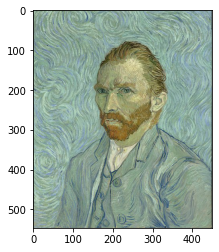

In [33]:
plt.imshow(style_image)

In [34]:
style_image = tf.keras.preprocessing.image.img_to_array(style_image)
style_image = style_image / 255
style_image = style_image[tf.newaxis, :]
style_image.shape

(1, 547, 450, 3)

In [35]:
content_layers = ["block4_conv2"]
style_layers = ["block1_conv1", "block2_conv1", "block3_conv1", "block4_conv1", "block5_conv1"]

In [36]:
[network.get_layer(name).output for name in style_layers]

[<KerasTensor: shape=(None, None, None, 64) dtype=float32 (created by layer 'block1_conv1')>,
 <KerasTensor: shape=(None, None, None, 128) dtype=float32 (created by layer 'block2_conv1')>,
 <KerasTensor: shape=(None, None, None, 256) dtype=float32 (created by layer 'block3_conv1')>,
 <KerasTensor: shape=(None, None, None, 512) dtype=float32 (created by layer 'block4_conv1')>,
 <KerasTensor: shape=(None, None, None, 512) dtype=float32 (created by layer 'block5_conv1')>]

In [37]:
network.input

<KerasTensor: shape=(None, None, None, 3) dtype=float32 (created by layer 'input_2')>

In [38]:
def vgg_layers(layer_names):
    vgg = tf.keras.applications.VGG19(include_top = False, weights = "imagenet")
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]
    network = tf.keras.Model(inputs = [vgg.input], outputs = outputs)

    return network

In [39]:
style_extractor = vgg_layers(style_layers)

In [40]:
style_extractor.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0     

In [41]:
len(style_extractor.layers)

18

In [42]:
style_extractor.outputs

[<KerasTensor: shape=(None, None, None, 64) dtype=float32 (created by layer 'block1_conv1')>,
 <KerasTensor: shape=(None, None, None, 128) dtype=float32 (created by layer 'block2_conv1')>,
 <KerasTensor: shape=(None, None, None, 256) dtype=float32 (created by layer 'block3_conv1')>,
 <KerasTensor: shape=(None, None, None, 512) dtype=float32 (created by layer 'block4_conv1')>,
 <KerasTensor: shape=(None, None, None, 512) dtype=float32 (created by layer 'block5_conv1')>]

In [43]:
style_outputs = style_extractor(style_image)

In [44]:
len(style_outputs)

5

In [45]:
style_outputs[1]

<tf.Tensor: shape=(1, 273, 225, 128), dtype=float32, numpy=
array([[[[ 0.        ,  0.        ,  0.        , ...,  7.5789084 ,
           0.        , 12.378425  ],
         [ 0.        ,  0.        ,  0.6433048 , ...,  3.1512532 ,
           0.        ,  1.2021832 ],
         [ 0.        ,  0.        ,  2.132823  , ...,  7.2468843 ,
           0.        ,  1.8726162 ],
         ...,
         [ 0.        ,  0.        ,  0.59423363, ...,  5.4648366 ,
           0.        ,  1.9362189 ],
         [ 0.        ,  0.        ,  2.5481849 , ..., 10.11625   ,
           0.        ,  4.477747  ],
         [ 0.        ,  0.        , 11.865049  , ..., 12.327753  ,
           0.        ,  0.        ]],

        [[ 0.        ,  4.920423  ,  0.        , ...,  5.601665  ,
           0.        , 13.423126  ],
         [ 0.        ,  6.237653  ,  0.        , ...,  1.0133301 ,
           3.4120326 ,  0.        ],
         [ 0.        ,  6.360746  ,  0.23944053, ...,  5.5656724 ,
           5.1509047 ,  0

In [46]:
style_outputs[0].shape, style_outputs[1].shape, style_outputs[2].shape, style_outputs[3].shape, style_outputs[4].shape 

(TensorShape([1, 547, 450, 64]),
 TensorShape([1, 273, 225, 128]),
 TensorShape([1, 136, 112, 256]),
 TensorShape([1, 68, 56, 512]),
 TensorShape([1, 34, 28, 512]))

In [47]:
def gram_matrix(layer_activation):
    result = tf.linalg.einsum("bijc, bijd->bcd", layer_activation, layer_activation)
    input_shape = tf.shape(layer_activation)
    num_locations = tf.cast(input_shape[1] * input_shape[2], tf.float32)

    return result / num_locations

In [48]:
gram_matrix(style_outputs[0])

<tf.Tensor: shape=(1, 64, 64), dtype=float32, numpy=
array([[[0.59758645, 0.25278747, 0.30150723, ..., 0.0109184 ,
         0.37434384, 0.46900588],
        [0.25278747, 0.12396739, 0.14012769, ..., 0.00430842,
         0.16983671, 0.20670335],
        [0.30150723, 0.14012769, 0.164949  , ..., 0.00383255,
         0.20415045, 0.25035354],
        ...,
        [0.0109184 , 0.00430842, 0.00383255, ..., 0.00383184,
         0.00720541, 0.00735993],
        [0.37434384, 0.16983671, 0.20415045, ..., 0.00720541,
         0.27430022, 0.32599902],
        [0.46900588, 0.20670335, 0.25035354, ..., 0.00735993,
         0.32599902, 0.39686823]]], dtype=float32)>

In [49]:
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super().__init__()
        self.vgg = vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        inputs = inputs * 255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs = outputs[:self.num_style_layers]
        content_outputs = outputs[self.num_style_layers:]

        style_outputs = [gram_matrix(style_output) for style_output in style_outputs]

        content_dict = {
            content_name : value for content_name,
            value in zip(self.content_layers, content_outputs)
        }
        style_dict = {
            style_name : value for style_name,
            value in zip(self.style_layers, style_outputs)
        }
        return {"content": content_dict, "style": style_dict}


In [50]:
style_layers, content_layers

(['block1_conv1',
  'block2_conv1',
  'block3_conv1',
  'block4_conv1',
  'block5_conv1'],
 ['block4_conv2'])

In [51]:
extractor = StyleContentModel(style_layers, content_layers)

In [52]:
results = extractor(content_image)

In [53]:
results

{'content': {'block4_conv2': <tf.Tensor: shape=(1, 120, 80, 512), dtype=float32, numpy=
  array([[[[ 195.09041 ,  370.6723  , 2919.5452  , ..., 1345.4834  ,
            1160.0017  ,    0.      ],
           [   0.      ,    0.      ,  676.09033 , ..., 1614.902   ,
            1028.3427  ,    0.      ],
           [ 504.70306 ,    0.      ,    0.      , ...,  853.49744 ,
             245.25044 ,    0.      ],
           ...,
           [   0.      ,    0.      ,  523.03326 , ...,  150.64226 ,
              30.776447,    0.      ],
           [   0.      ,    0.      ,  809.83203 , ...,  323.09384 ,
             179.45726 ,    0.      ],
           [ 335.45792 ,    0.      ,  445.80505 , ...,  412.51074 ,
             187.32019 ,    0.      ]],
  
          [[   0.      ,    0.      , 3175.236   , ..., 1189.0316  ,
            1659.2512  ,    0.      ],
           [   0.      ,    0.      ,  967.7387  , ...,    0.      ,
            1266.1042  ,    0.      ],
           [   0.      ,    

In [54]:
for key, value in results.items():
    print(key, value.keys())

content dict_keys(['block4_conv2'])
style dict_keys(['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1'])


In [55]:
style_targets = extractor(style_image)["style"]
content_targets = extractor(content_image)["content"]

In [56]:
len(style_targets), len(content_targets)

(5, 1)

In [57]:
new_image = tf.Variable(content_image)

In [58]:
content_weight = 1
style_weight = 100

In [59]:
optimizer = tf.optimizers.Adam(learning_rate = 0.02)

In [60]:
# 학습 시작

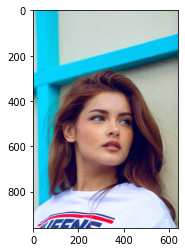

In [61]:
plt.imshow(tf.squeeze(content_image, axis = 0))

Epoch 5 | content loss: 224530.5 | style loss: 9559649280.0 | total loss 955965112320.0


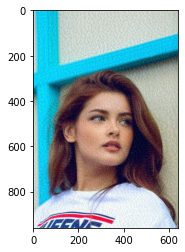

Epoch 10 | content loss: 269300.375 | style loss: 3892407040.0 | total loss 389240979456.0


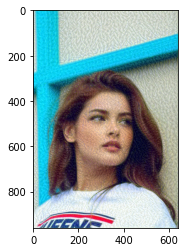

Epoch 15 | content loss: 284064.59375 | style loss: 2123491328.0 | total loss 212349403136.0


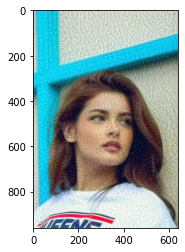

Epoch 20 | content loss: 290199.71875 | style loss: 1302257024.0 | total loss 130225987584.0


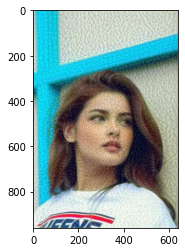

Epoch 25 | content loss: 294168.3125 | style loss: 886432640.0 | total loss 88643559424.0


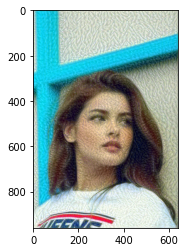

Epoch 30 | content loss: 298019.71875 | style loss: 650264448.0 | total loss 65026744320.0


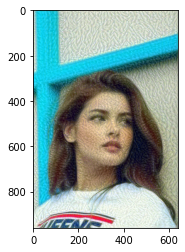

Epoch 35 | content loss: 301383.5625 | style loss: 508574976.0 | total loss 50857799680.0


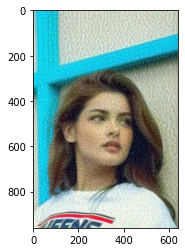

Epoch 40 | content loss: 304145.53125 | style loss: 415502944.0 | total loss 41550598144.0


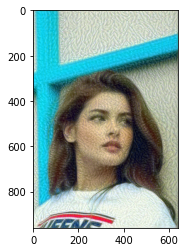

Epoch 45 | content loss: 306910.8125 | style loss: 351991040.0 | total loss 35199410176.0


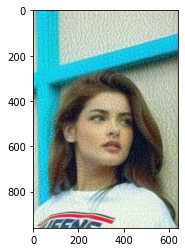

Epoch 50 | content loss: 308838.34375 | style loss: 305421920.0 | total loss 30542501888.0


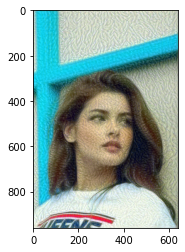

Epoch 55 | content loss: 310502.40625 | style loss: 271886464.0 | total loss 27188957184.0


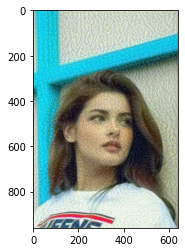

Epoch 60 | content loss: 311675.28125 | style loss: 245363984.0 | total loss 24536709120.0


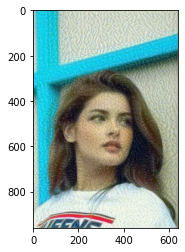

Epoch 65 | content loss: 312434.53125 | style loss: 224305952.0 | total loss 22430908416.0


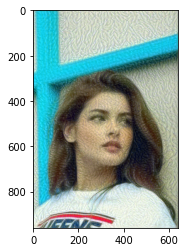

Epoch 70 | content loss: 313353.0 | style loss: 207285072.0 | total loss 20728819712.0


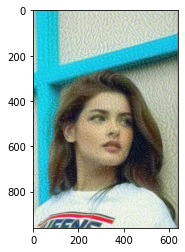

Epoch 75 | content loss: 314311.3125 | style loss: 193164144.0 | total loss 19316727808.0


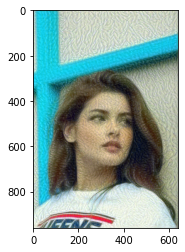

Epoch 80 | content loss: 314873.0 | style loss: 181168416.0 | total loss 18117156864.0


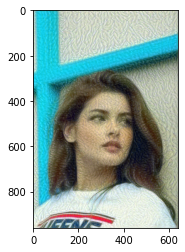

Epoch 85 | content loss: 315557.59375 | style loss: 170889616.0 | total loss 17089276928.0


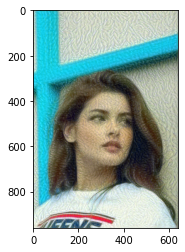

Epoch 90 | content loss: 316149.0 | style loss: 161955184.0 | total loss 16195834880.0


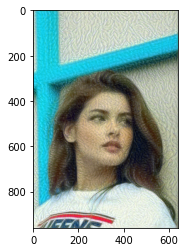

Epoch 95 | content loss: 316668.4375 | style loss: 154069008.0 | total loss 15407217664.0


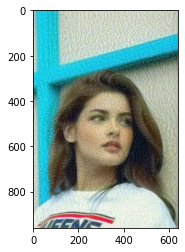

Epoch 100 | content loss: 317203.03125 | style loss: 147042944.0 | total loss 14704611328.0


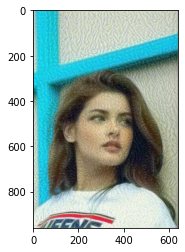

Epoch 105 | content loss: 317681.75 | style loss: 140725152.0 | total loss 14072833024.0


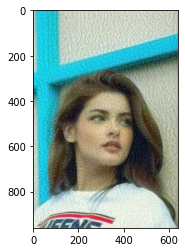

Epoch 110 | content loss: 318125.59375 | style loss: 135001568.0 | total loss 13500475392.0


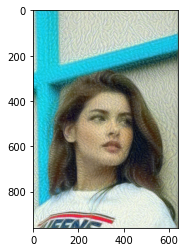

Epoch 115 | content loss: 318592.84375 | style loss: 129781400.0 | total loss 12978458624.0


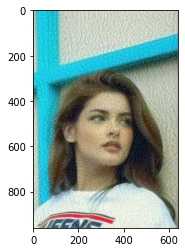

Epoch 120 | content loss: 319012.625 | style loss: 124997928.0 | total loss 12500112384.0


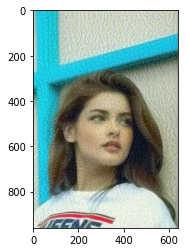

Epoch 125 | content loss: 319437.5 | style loss: 120586832.0 | total loss 12059002880.0


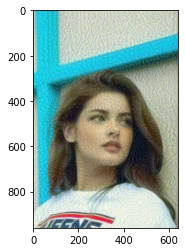

Epoch 130 | content loss: 319856.28125 | style loss: 116503144.0 | total loss 11650633728.0


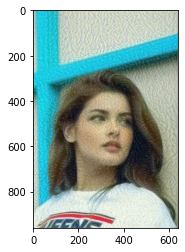

Epoch 135 | content loss: 320256.625 | style loss: 112709888.0 | total loss 11271309312.0


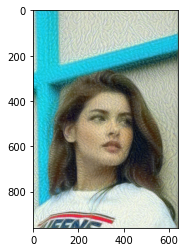

Epoch 140 | content loss: 320646.46875 | style loss: 109174360.0 | total loss 10917756928.0


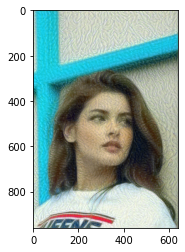

Epoch 145 | content loss: 321022.0 | style loss: 105869248.0 | total loss 10587245568.0


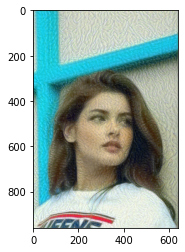

Epoch 150 | content loss: 321390.09375 | style loss: 102770632.0 | total loss 10277385216.0


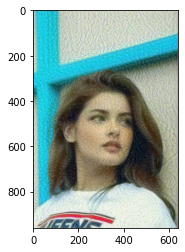

Epoch 155 | content loss: 321753.59375 | style loss: 99857280.0 | total loss 9986050048.0


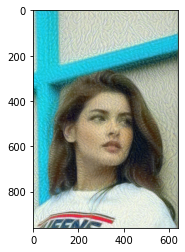

Epoch 160 | content loss: 322109.125 | style loss: 97111016.0 | total loss 9711424512.0


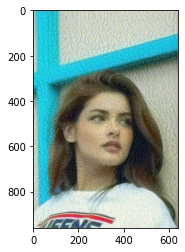

Epoch 165 | content loss: 322463.53125 | style loss: 94516952.0 | total loss 9452017664.0


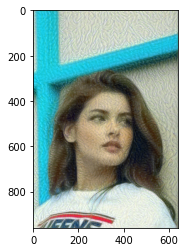

Epoch 170 | content loss: 322812.46875 | style loss: 92061456.0 | total loss 9206468608.0


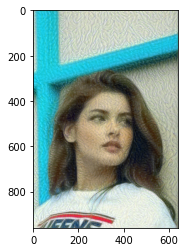

Epoch 175 | content loss: 323153.71875 | style loss: 89732192.0 | total loss 8973542400.0


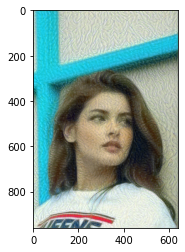

Epoch 180 | content loss: 323486.59375 | style loss: 87517968.0 | total loss 8752120832.0


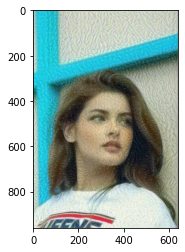

Epoch 185 | content loss: 323806.09375 | style loss: 85410440.0 | total loss 8541367808.0


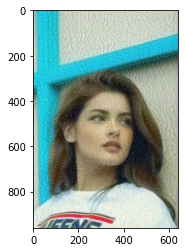

Epoch 190 | content loss: 324123.5625 | style loss: 83401040.0 | total loss 8340428288.0


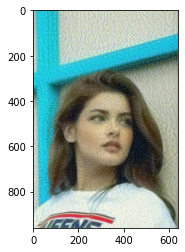

Epoch 195 | content loss: 324439.9375 | style loss: 81482480.0 | total loss 8148572672.0


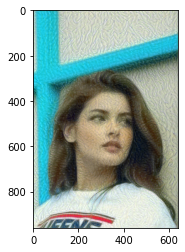

Epoch 200 | content loss: 324747.59375 | style loss: 79647920.0 | total loss 7965116416.0


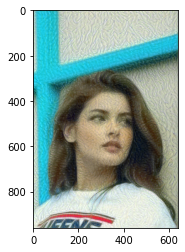

Epoch 205 | content loss: 325072.3125 | style loss: 77894200.0 | total loss 7789745152.0


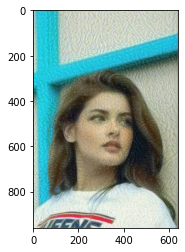

Epoch 210 | content loss: 325172.625 | style loss: 76404944.0 | total loss 7640819712.0


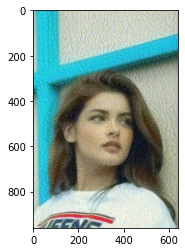

Epoch 215 | content loss: 327399.0 | style loss: 93063664.0 | total loss 9306693632.0


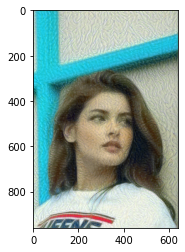

Epoch 220 | content loss: 324299.03125 | style loss: 82763992.0 | total loss 8276723200.0


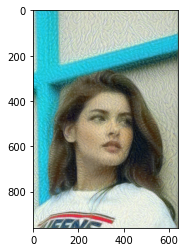

Epoch 225 | content loss: 327733.59375 | style loss: 98891352.0 | total loss 9889463296.0


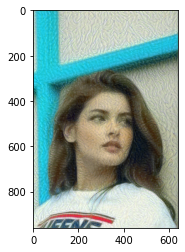

Epoch 230 | content loss: 325027.84375 | style loss: 74423776.0 | total loss 7442702848.0


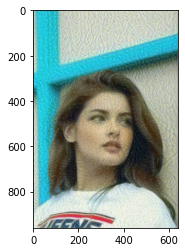

Epoch 235 | content loss: 325265.15625 | style loss: 72479912.0 | total loss 7248316416.0


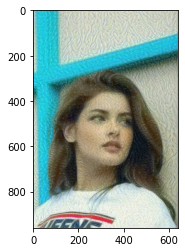

Epoch 240 | content loss: 326901.53125 | style loss: 71442616.0 | total loss 7144588288.0


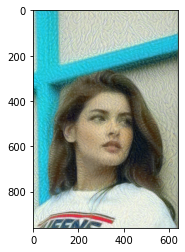

Epoch 245 | content loss: 325853.8125 | style loss: 70191008.0 | total loss 7019426304.0


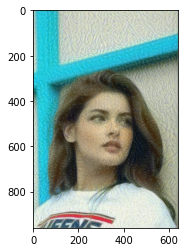

Epoch 250 | content loss: 327626.25 | style loss: 68577584.0 | total loss 6858085888.0


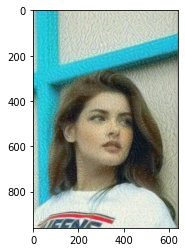

Epoch 255 | content loss: 326813.1875 | style loss: 66059744.0 | total loss 6606301184.0


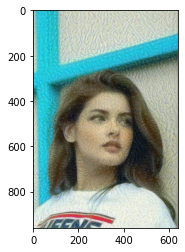

Epoch 260 | content loss: 327661.25 | style loss: 63660708.0 | total loss 6366398464.0


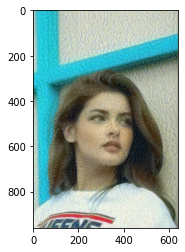

Epoch 265 | content loss: 328147.71875 | style loss: 62663492.0 | total loss 6266677248.0


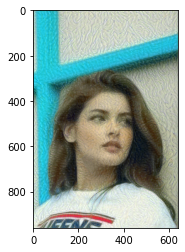

Epoch 270 | content loss: 328031.28125 | style loss: 61128324.0 | total loss 6113160704.0


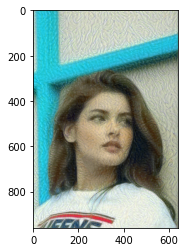

Epoch 275 | content loss: 328258.9375 | style loss: 60063124.0 | total loss 6006640640.0


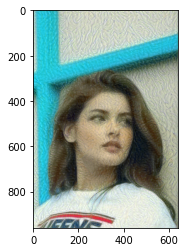

Epoch 280 | content loss: 328588.90625 | style loss: 58836448.0 | total loss 5883973632.0


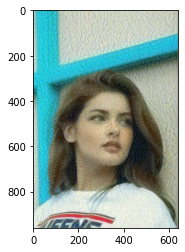

Epoch 285 | content loss: 328841.1875 | style loss: 57707720.0 | total loss 5771100672.0


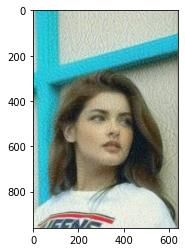

Epoch 290 | content loss: 329081.375 | style loss: 56677016.0 | total loss 5668030976.0


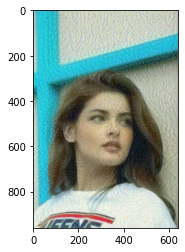

Epoch 295 | content loss: 329305.96875 | style loss: 55696976.0 | total loss 5570027008.0


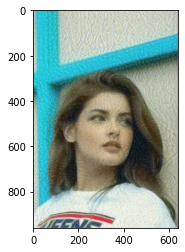

Epoch 300 | content loss: 329559.3125 | style loss: 54731404.0 | total loss 5473469952.0


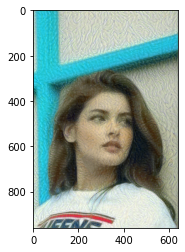

Epoch 305 | content loss: 329871.90625 | style loss: 53806676.0 | total loss 5380997120.0


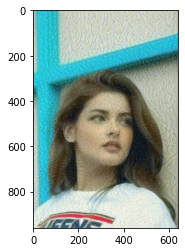

Epoch 310 | content loss: 330044.375 | style loss: 52908288.0 | total loss 5291159040.0


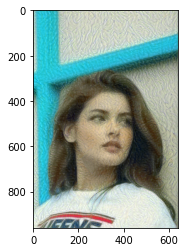

Epoch 315 | content loss: 330173.78125 | style loss: 52070552.0 | total loss 5207385600.0


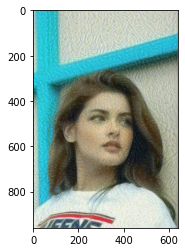

Epoch 320 | content loss: 330725.65625 | style loss: 51684976.0 | total loss 5168828416.0


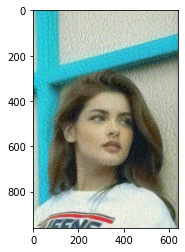

Epoch 325 | content loss: 329069.71875 | style loss: 63694628.0 | total loss 6369792000.0


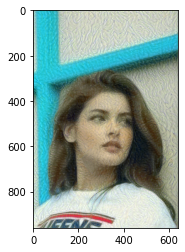

Epoch 330 | content loss: 332103.4375 | style loss: 57701556.0 | total loss 5770487808.0


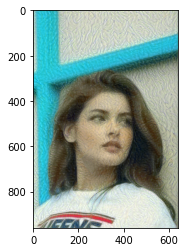

Epoch 335 | content loss: 331012.9375 | style loss: 50114244.0 | total loss 5011755520.0


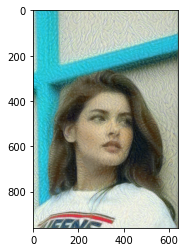

Epoch 340 | content loss: 330080.75 | style loss: 53182340.0 | total loss 5318564352.0


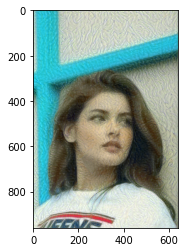

Epoch 345 | content loss: 330375.78125 | style loss: 49968676.0 | total loss 4997197824.0


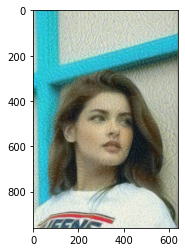

Epoch 350 | content loss: 331255.96875 | style loss: 48413284.0 | total loss 4841659904.0


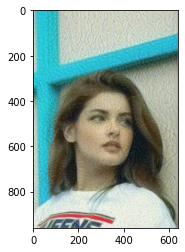

Epoch 355 | content loss: 331598.25 | style loss: 47588048.0 | total loss 4759136768.0


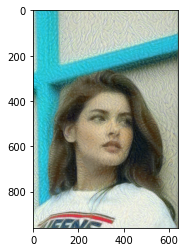

Epoch 360 | content loss: 331687.90625 | style loss: 45955460.0 | total loss 4595877888.0


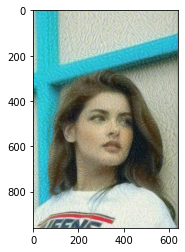

Epoch 365 | content loss: 331831.71875 | style loss: 45610612.0 | total loss 4561393152.0


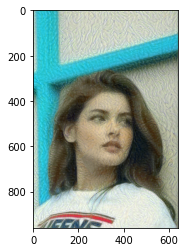

Epoch 370 | content loss: 332036.15625 | style loss: 44716092.0 | total loss 4471941632.0


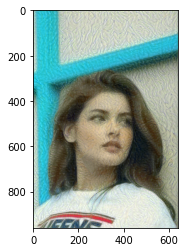

Epoch 375 | content loss: 332245.0625 | style loss: 43851968.0 | total loss 4385529344.0


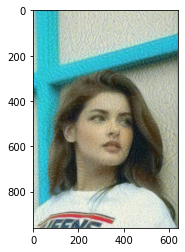

Epoch 380 | content loss: 332470.75 | style loss: 43158328.0 | total loss 4316165120.0


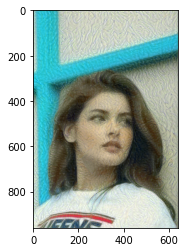

Epoch 385 | content loss: 332635.375 | style loss: 42521224.0 | total loss 4252454912.0


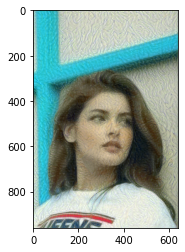

Epoch 390 | content loss: 332808.46875 | style loss: 41911356.0 | total loss 4191468288.0


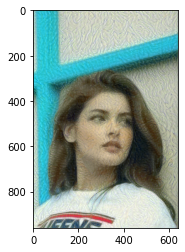

Epoch 395 | content loss: 333114.03125 | style loss: 41375348.0 | total loss 4137867776.0


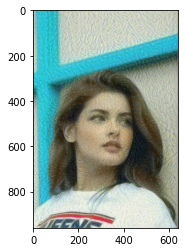

Epoch 400 | content loss: 332139.90625 | style loss: 45543244.0 | total loss 4554656768.0


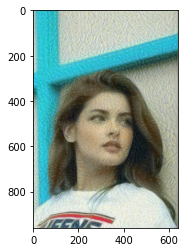

Epoch 405 | content loss: 338688.125 | style loss: 162876720.0 | total loss 16288011264.0


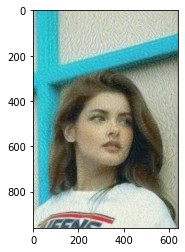

Epoch 410 | content loss: 334585.59375 | style loss: 62759032.0 | total loss 6276237312.0


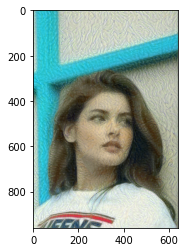

Epoch 415 | content loss: 329146.25 | style loss: 73847992.0 | total loss 7385128448.0


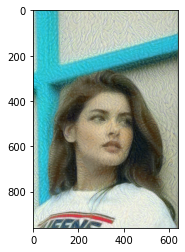

Epoch 420 | content loss: 333785.6875 | style loss: 57156008.0 | total loss 5715934720.0


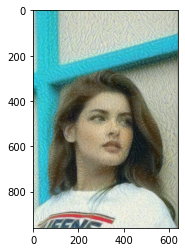

Epoch 425 | content loss: 331103.9375 | style loss: 46901708.0 | total loss 4690502144.0


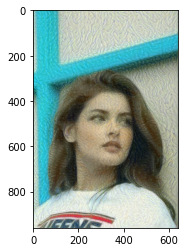

Epoch 430 | content loss: 333122.8125 | style loss: 43115412.0 | total loss 4311874560.0


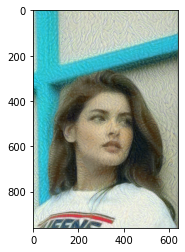

Epoch 435 | content loss: 332378.1875 | style loss: 41192812.0 | total loss 4119613440.0


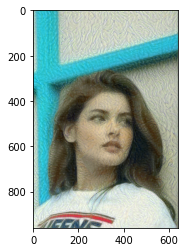

Epoch 440 | content loss: 333457.53125 | style loss: 39602824.0 | total loss 3960615936.0


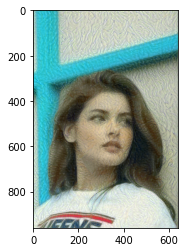

Epoch 445 | content loss: 333388.3125 | style loss: 38411904.0 | total loss 3841523712.0


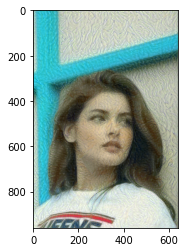

Epoch 450 | content loss: 333637.53125 | style loss: 37595024.0 | total loss 3759835904.0


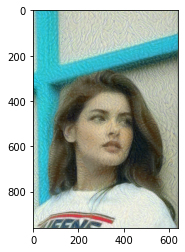

Epoch 455 | content loss: 334243.625 | style loss: 37070356.0 | total loss 3707369984.0


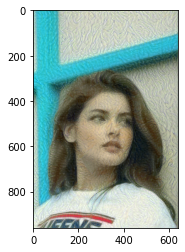

Epoch 460 | content loss: 333986.34375 | style loss: 36398516.0 | total loss 3640185600.0


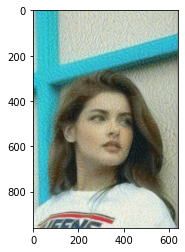

Epoch 465 | content loss: 334408.5 | style loss: 35586284.0 | total loss 3558962688.0


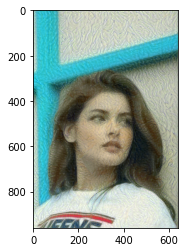

Epoch 470 | content loss: 334720.375 | style loss: 35072776.0 | total loss 3507612416.0


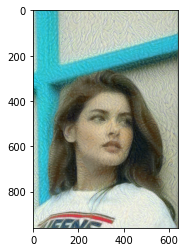

Epoch 475 | content loss: 334856.3125 | style loss: 34463188.0 | total loss 3446653696.0


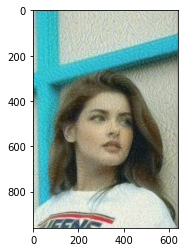

Epoch 480 | content loss: 334897.65625 | style loss: 33950424.0 | total loss 3395377152.0


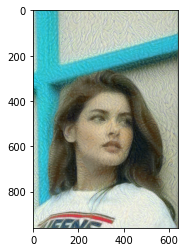

Epoch 485 | content loss: 335100.0625 | style loss: 33463948.0 | total loss 3346729984.0


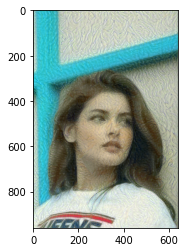

Epoch 490 | content loss: 335241.4375 | style loss: 33055028.0 | total loss 3305838080.0


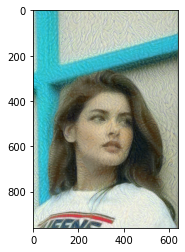

Epoch 495 | content loss: 335575.71875 | style loss: 34167764.0 | total loss 3417112064.0


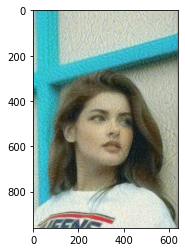

Epoch 500 | content loss: 335219.90625 | style loss: 45339876.0 | total loss 4534323200.0


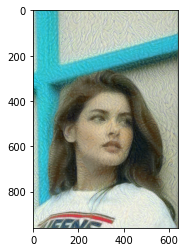

In [62]:
epochs = 500
print_every = 5

for epoch in range(epochs):
    with tf.GradientTape() as tape:
        outputs = extractor(new_image)

        content_outputs = outputs["content"]
        style_outputs = outputs["style"]

        content_loss = tf.add_n([
            tf.reduce_mean(
                (content_outputs[name] - content_targets[name]) ** 2) for name in content_outputs.keys()
        ])
        style_loss = tf.add_n([
            tf.reduce_mean(
                (style_outputs[name] - style_targets[name]) ** 2) for name in style_outputs.keys()
        ])

        total_loss = content_loss * content_weight  + style_loss * style_weight
    
    gradient = tape.gradient(total_loss, new_image)
    optimizer.apply_gradients([(gradient, new_image)])

    new_image.assign(tf.clip_by_value(new_image, 0.0, 1.0))

    if (epoch + 1) % print_every == 0:
        print("Epoch {} | content loss: {} | style loss: {} | total loss {}"
        .format(epoch + 1, content_loss, style_loss, total_loss))
        plt.imshow(tf.squeeze(new_image, axis = 0))
        plt.show()
